In [39]:
from matplotlib import pyplot as plt
from skimage import io
import numpy as np
import os
import keras

def list_files(startpath):
    for root, dirs, files in os.walk(startpath):
        if './.git' not in root:
            level = root.replace(startpath, '').count(os.sep)
            if level < 6:
                indent = ' ' * 4 * (level)
                print('{}{}/'.format(indent, os.path.basename(root)))
                subindent = ' ' * 4 * (level + 1)
                for f in files:
                    print('{}{}'.format(subindent, f))

list_files('.')

./
    log_GANs_CUDAMEMORy
    log_big_models_NOTLBIG_DATAMEMORY0
    log_file_not_big_models_data_on_memory
    log_big_models_NOTLBIG_DATAMEMORY1_datasampling1
    Visualize.ipynb
    pyproject.toml
    evaluate_big_models.py
    Visualize_results.ipynb
    IMPORTANT_printing_ONLIVE_RANDOM
    IMPORTANT_printing_ONLIVE_PDF
    log_file_big_models
    .gitignore
    poetry.lock
    README.md
    predict.py
    requirements.txt
    Makefile
    environment.yml
    IMPORTANT_printing_ONMEMORY_RANDOM
    evaluate_2.py
    IMPORTANT_printing_ONMEMORY_PDF
    evaluate_0.py
    Visualize copy.ipynb
    log_big_models_NOTLBIG_DATAMEMORY1
    log_file_not_big_models
    evaluate_lr.py
    log_GANs_CUDAMEMORY_2
    log_GANs
    conf/
        big_models.yaml
        config.yaml
        dataset/
            default.yaml
        model/
            default.yaml
            big_models.yaml
        hyperparam/
            default.yaml
    big_models_NOTLBIG_DATAMEMORY0/
        LiveFActinDataset/
  

In [40]:
model = 'unet'

big_models = './big_models_ACTUALBIG'
not_big_models = './big_models_NOTLBIG'
not_big_models_memory1 = './big_models_NOTLBIG_DATAMEMORY1'
not_big_models_memory0 = './big_models_NOTLBIG_DATAMEMORY0'

path_dict = {}

path_dict['Small'] = (os.path.join('./big_models_ACTUALBIG', 'LiveFActinDataset', model, 'scaleNone/epc10_btch8_lr0.001_optim-adam_lrsched-OneCycle_seed666_1'))
path_dict['Only BIG'] = (os.path.join('./big_models_ACTUALBIG', 'LiveFActinDataset', model, 'scaleNone/epc10_btch8_lr0.001_optim-adam_lrsched-OneCycle_seed666_2'))
path_dict['Small'] = (os.path.join('./big_models_NOTLBIG', 'LiveFActinDataset', model, 'scaleNone/epc10_btch8_lr0.001_optim-adam_lrsched-OneCycle_seed666_1'))
path_dict['Small - On memory 1'] = (os.path.join('./big_models_NOTLBIG_DATAMEMORY1', 'LiveFActinDataset', model, 'scaleNone/epc10_btch8_lr0.001_optim-adam_lrsched-OneCycle_seed666_1'))
path_dict['Small - On memory 2'] = (os.path.join('./big_models_NOTLBIG_DATAMEMORY1', 'LiveFActinDataset', model, 'scaleNone/epc10_btch8_lr0.001_optim-adam_lrsched-OneCycle_seed666_2'))
path_dict['Small - On memory 50epch'] = (os.path.join('./big_models_NOTLBIG_DATAMEMORY1', 'LiveFActinDataset', model, 'scaleNone/epc50_btch8_lr0.001_optim-adam_lrsched-OneCycle_seed666_1'))
path_dict['Small - On live'] = (os.path.join('./big_models_NOTLBIG_DATAMEMORY0', 'LiveFActinDataset', model, 'scaleNone/epc10_btch8_lr0.001_optim-adam_lrsched-OneCycle_seed666_1'))
path_dict['Small - memory 1 50 epochs'] = (os.path.join('./big_models_ACTUALBIG_memory1', 'LiveFActinDataset', model, 'scaleNone/epc50_btch8_lr0.001_optim-adam_lrsched-OneCycle_seed666_1'))
path_dict['Small - sampling 1'] = (os.path.join('./big_models_NOTLBIG_DATAMEMORY1_datasampling1', 'LiveFActinDataset', model, 'scaleNone/epc50_btch8_lr0.001_optim-adam_lrsched-OneCycle_seed666_1'))


In [41]:
import yaml

for n, p in path_dict.items():
    # Read YAML file
    with open(os.path.join(p, "train_configuration.yaml"), 'r') as stream:
        data_loaded = yaml.safe_load(stream)
    print(f'{n}:\t {data_loaded}')


Small:	 {'dataset': {'EM': {'crappifier': 'em_gaussian_crappify', 'data_paths': [None, 'train', None, None, None, 'test'], 'patch_size_x': 64, 'patch_size_y': 64, 'scale': 4}, 'ER': {'crappifier': 'downsampleonly', 'data_paths': ['train/training_wf', 'train/training_gt', 'val/validate_wf', 'val/validate_gt', 'test/test_wf/level_01', 'test/test_gt/level_06'], 'patch_size_x': 128, 'patch_size_y': 128, 'scale': None}, 'F-actin': {'crappifier': 'downsampleonly', 'data_paths': ['train/training_wf', 'train/training_gt', 'val/validate_wf', 'val/validate_gt', 'test/test_wf/level_01', 'test/test_gt'], 'patch_size_x': 128, 'patch_size_y': 128, 'scale': None}, 'LiveFActinDataset': {'crappifier': 'downsampleonly', 'data_paths': ['train_split/wf', 'train_split/gt', 'val_split/wf', 'val_split/gt', 'test_split/wf', 'test_split/gt'], 'patch_size_x': 128, 'patch_size_y': 128, 'scale': None}, 'MT': {'crappifier': 'downsampleonly', 'data_paths': ['train/training_wf', 'train/training_gt', 'val/validate_wf

In [42]:
for n, p in path_dict.items():
    print(f'{n} -> {p}')
    print(np.load(os.path.join(p, 'train_metrics', 'time.npy')))

Small -> ./big_models_NOTLBIG/LiveFActinDataset/unet/scaleNone/epc10_btch8_lr0.001_optim-adam_lrsched-OneCycle_seed666_1
[617.09880614]
Only BIG -> ./big_models_ACTUALBIG/LiveFActinDataset/unet/scaleNone/epc10_btch8_lr0.001_optim-adam_lrsched-OneCycle_seed666_2
[916.73688626]
Small - On memory 1 -> ./big_models_NOTLBIG_DATAMEMORY1/LiveFActinDataset/unet/scaleNone/epc10_btch8_lr0.001_optim-adam_lrsched-OneCycle_seed666_1
[41.40306544]
Small - On memory 2 -> ./big_models_NOTLBIG_DATAMEMORY1/LiveFActinDataset/unet/scaleNone/epc10_btch8_lr0.001_optim-adam_lrsched-OneCycle_seed666_2
[43.02124286]
Small - On memory 50epch -> ./big_models_NOTLBIG_DATAMEMORY1/LiveFActinDataset/unet/scaleNone/epc50_btch8_lr0.001_optim-adam_lrsched-OneCycle_seed666_1
[191.73953843]
Small - On live -> ./big_models_NOTLBIG_DATAMEMORY0/LiveFActinDataset/unet/scaleNone/epc10_btch8_lr0.001_optim-adam_lrsched-OneCycle_seed666_1
[628.30999017]
Small - memory 1 50 epochs -> ./big_models_ACTUALBIG_memory1/LiveFActinDatas

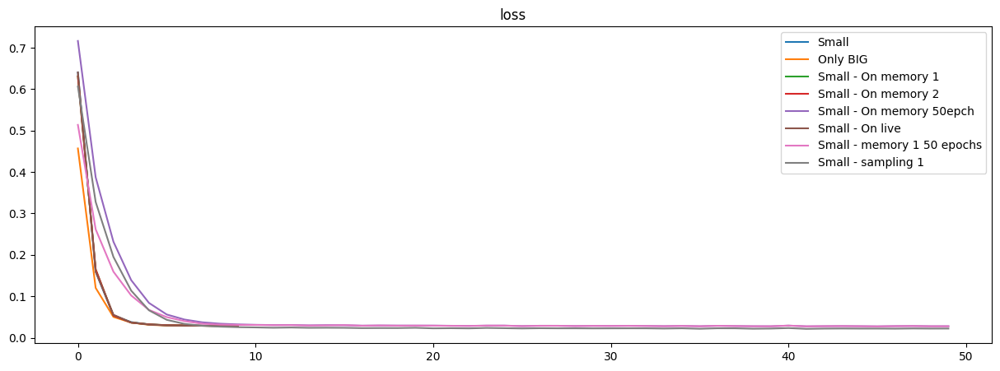

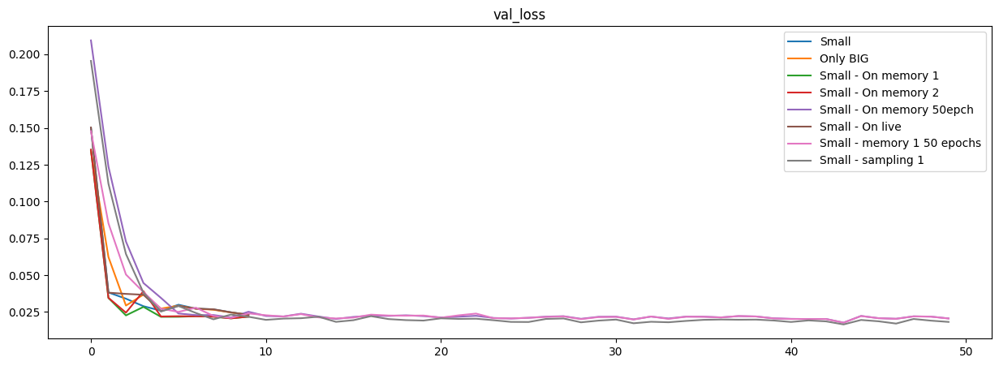

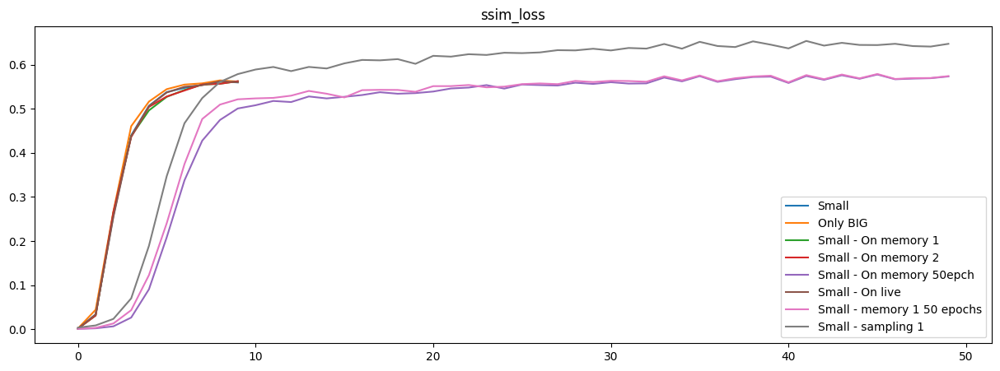

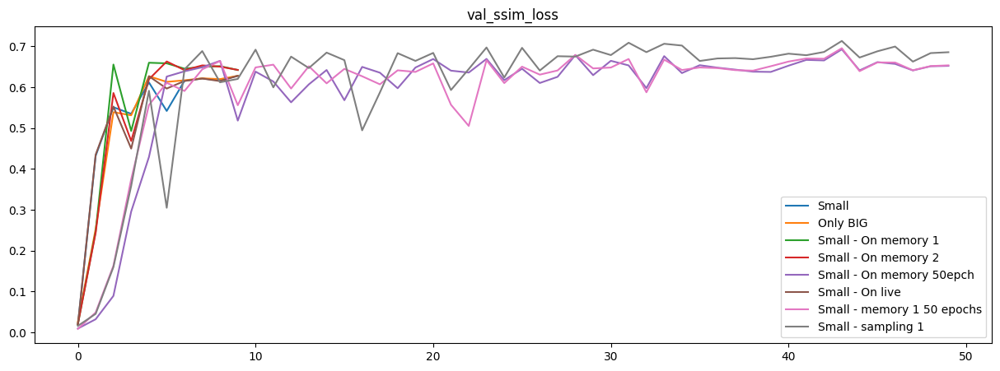

In [43]:
for metric in ['loss', 'val_loss', 'ssim_loss', 'val_ssim_loss']:
    plt.figure(figsize=(15,5))
    for n, p in path_dict.items():
        plt.plot(np.load(os.path.join(p, 'train_metrics', metric+'.npy')), label=n)
    plt.legend()
    plt.title(metric)
    plt.show()

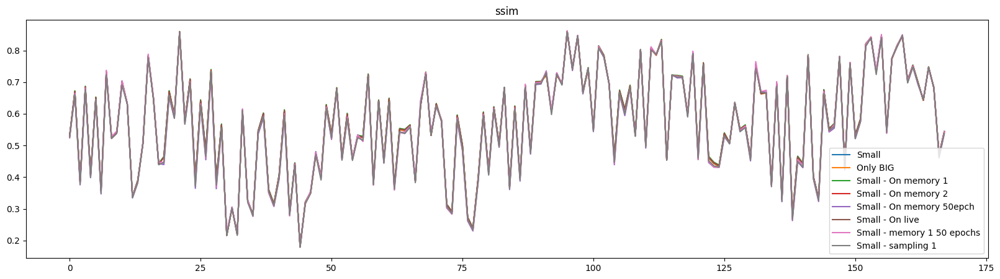

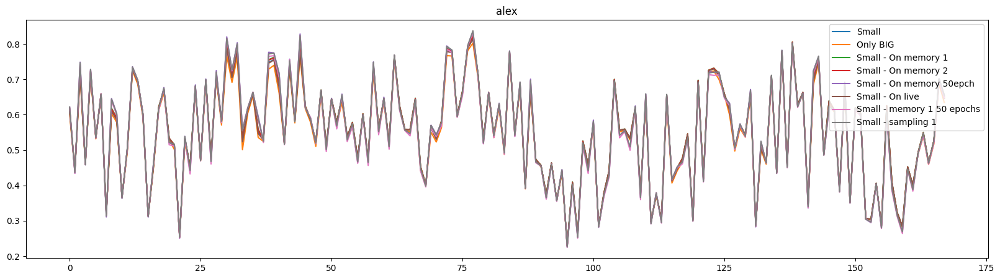

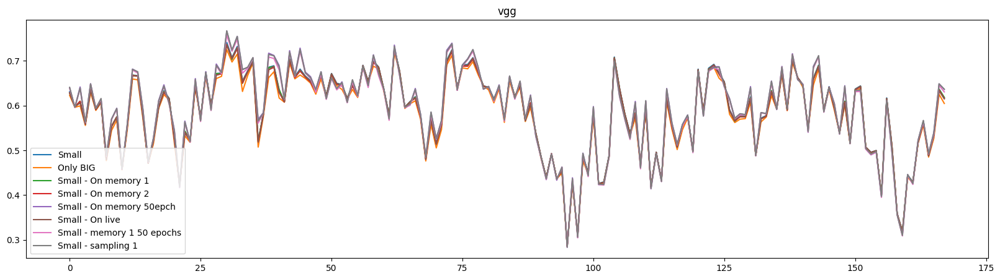

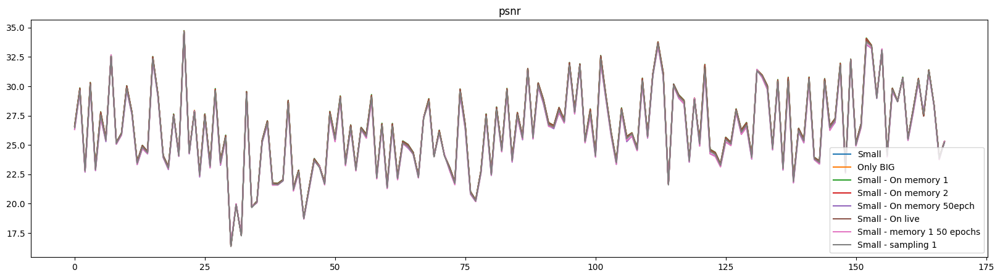

In [44]:

for metric in ['ssim', 'alex', 'vgg', 'psnr']:
    plt.figure(figsize=(20,5))
    for n, p in path_dict.items():
        plt.plot(np.load(os.path.join(p, 'test_metrics', metric+'.npy')), label=n)
    plt.title(metric)
    plt.legend()
    plt.show()

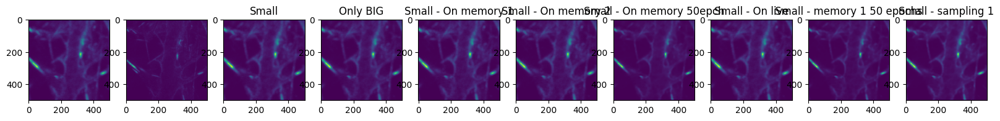

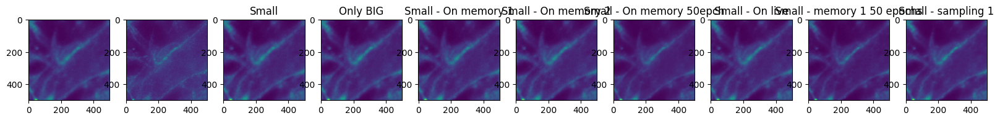

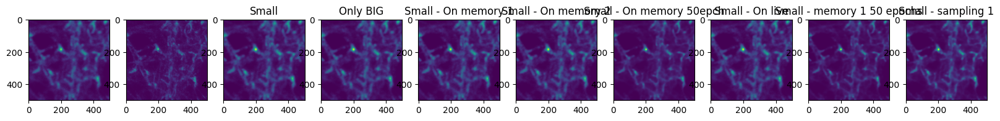

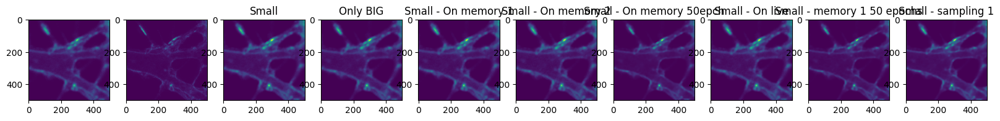

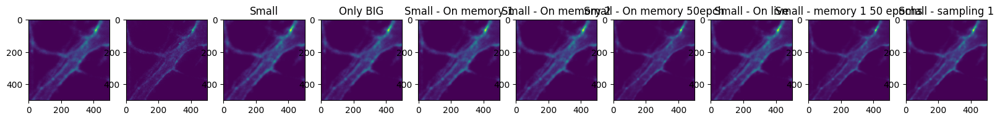

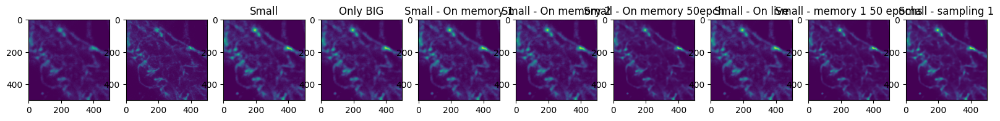

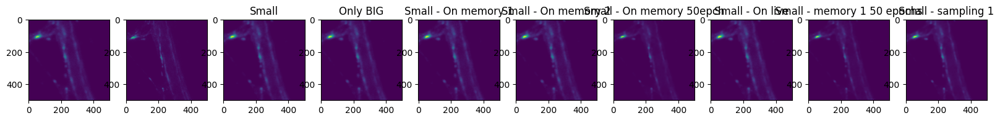

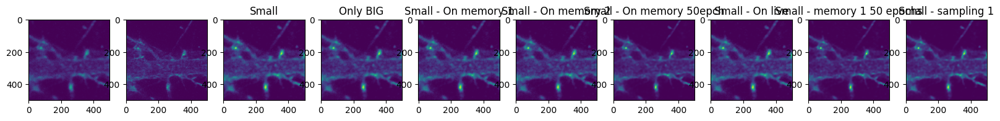

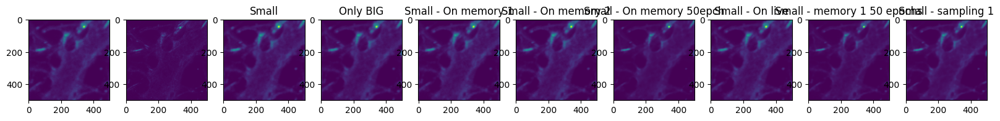

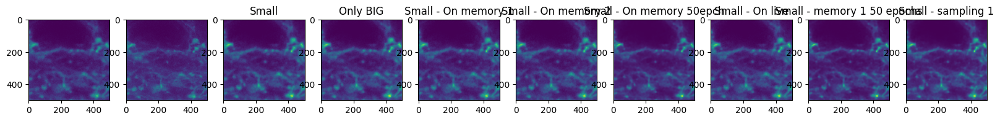

In [45]:
from skimage import io
for img_name in os.listdir('/data/ihidalgo/MicroscoPy/big_models_NOTLBIG_DATAMEMORY0/LiveFActinDataset/rcan/scaleNone/epc10_btch8_lr0.001_optim-adam_lrsched-OneCycle_seed666_1/predicted_images')[:10]:
    plt.figure(figsize=(20,10))
    cont = 3

    plt.subplot(1,len(path_dict)+2, 1)
    plt.imshow(io.imread(os.path.join('../datasets/LiveFActinDataset/test_split/wf/', img_name)), label='WF')
    plt.subplot(1,len(path_dict)+2, 2)
    plt.imshow(io.imread(os.path.join('../datasets/LiveFActinDataset/test_split/gt/', img_name)), label='GT')

    for n, p in path_dict.items():
        plt.subplot(1,len(path_dict)+2, cont)
        plt.imshow(io.imread(os.path.join(p, 'predicted_images', img_name)), label=n)
        plt.title(n)
        cont += 1
    plt.show()

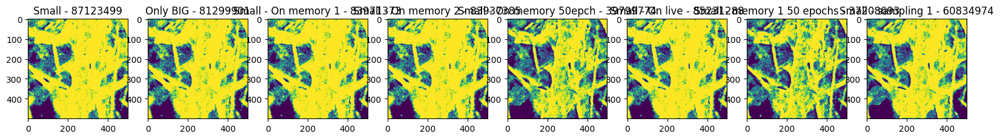

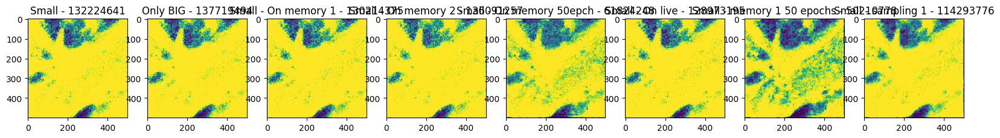

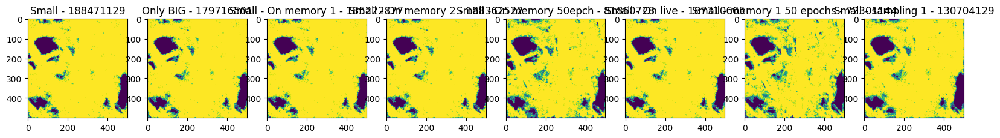

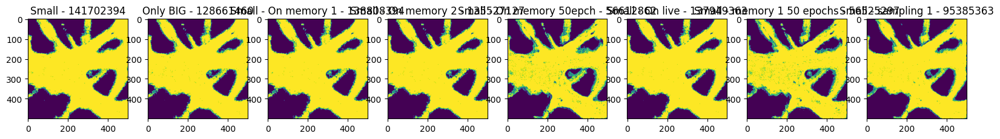

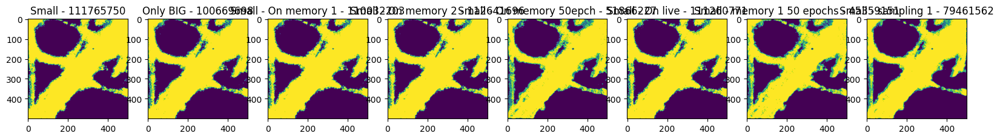

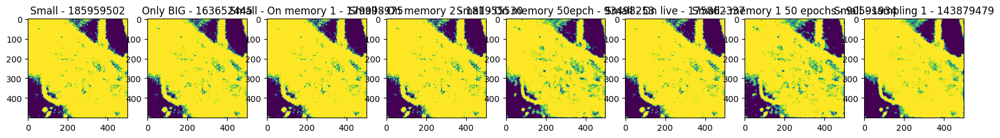

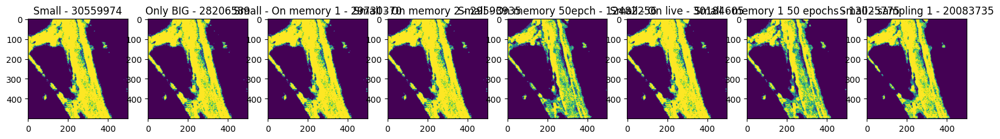

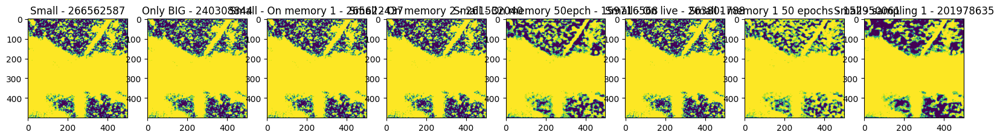

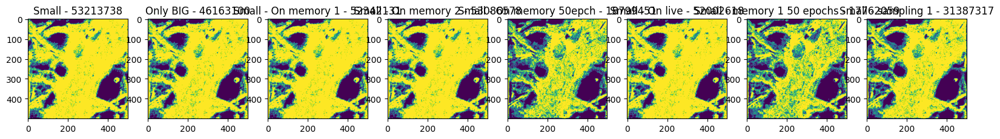

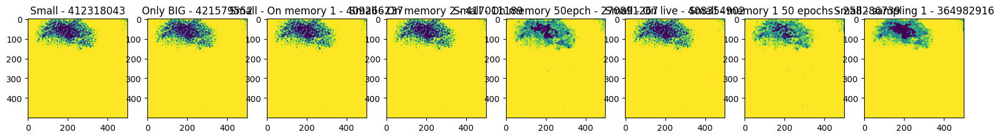

In [46]:
from skimage import io
for img_name in os.listdir('/data/ihidalgo/MicroscoPy/big_models_NOTLBIG_DATAMEMORY0/LiveFActinDataset/rcan/scaleNone/epc10_btch8_lr0.001_optim-adam_lrsched-OneCycle_seed666_1/predicted_images')[:10]:
    plt.figure(figsize=(20,5))

    base_img = io.imread(os.path.join('../datasets/LiveFActinDataset/test_split/gt/', img_name))

    cont = 1
    for n, p in path_dict.items():
        difference = base_img - io.imread(os.path.join(p, 'predicted_images', img_name))
        mse = np.sum(difference**2)
        plt.subplot(1,len(path_dict), cont)
        plt.imshow(difference, label=n)
        plt.title(f'{n} - {mse}')
        cont += 1
    plt.show()

2020-09-01_EXP0_5STED010.tif
GT - shape (600, 600) min 0 max 68
WF - shape (600, 600) min 0 max 68
Diff - shape (600, 600) min 0 max 65535


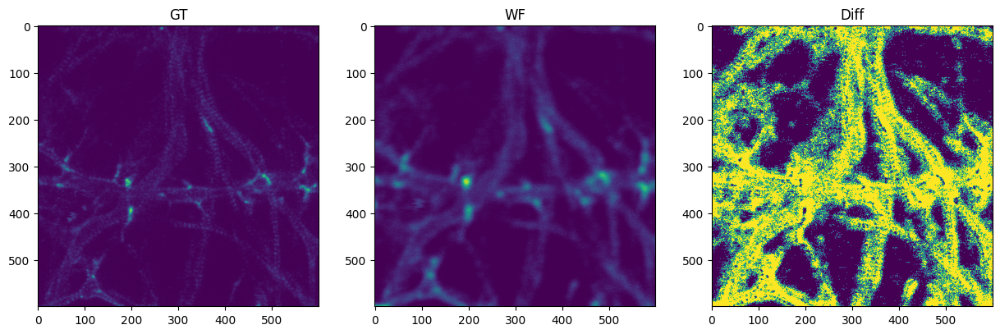

2020-09-01_EXP0_5STED020.tif
GT - shape (600, 600) min 0 max 103
WF - shape (600, 600) min 0 max 103
Diff - shape (600, 600) min 0 max 65535


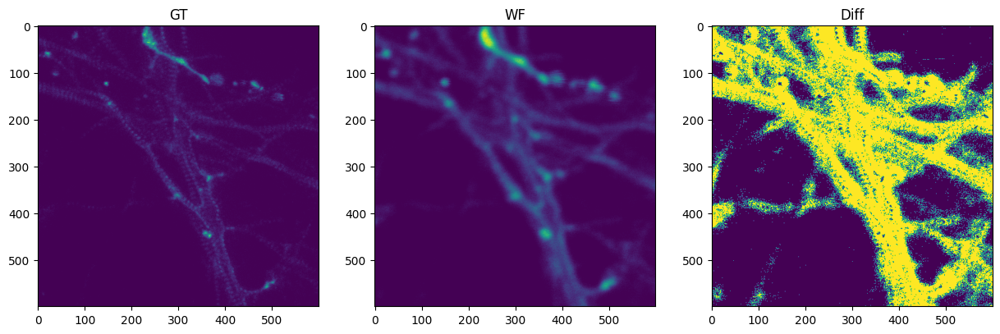

2020-09-01_EXP0_5STED030.tif
GT - shape (600, 600) min 0 max 146
WF - shape (600, 600) min 0 max 146
Diff - shape (600, 600) min 0 max 65535


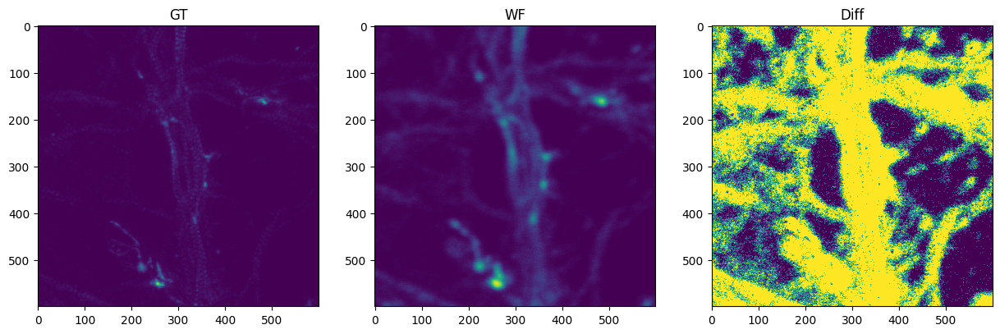

2020-09-01_EXP0_5STED040.tif
GT - shape (600, 600) min 0 max 111
WF - shape (600, 600) min 0 max 111
Diff - shape (600, 600) min 0 max 65535


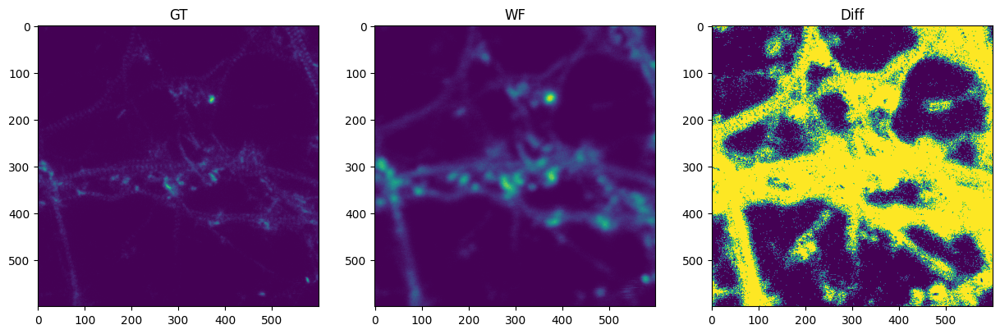

2020-09-01_EXP0_5STED050.tif
GT - shape (600, 600) min 0 max 104
WF - shape (600, 600) min 0 max 104
Diff - shape (600, 600) min 0 max 65535


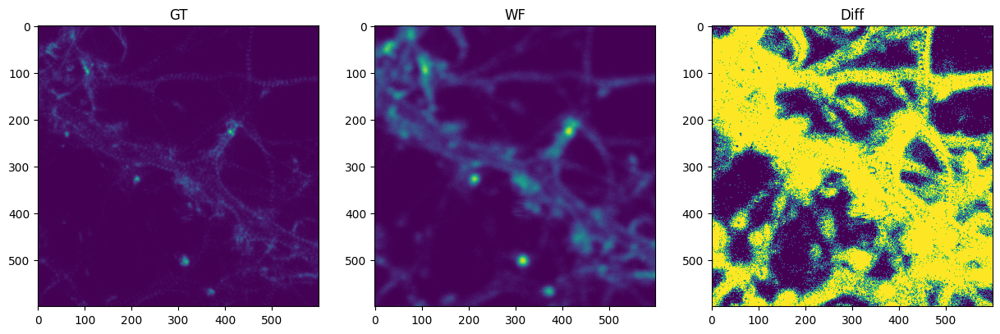

2020-09-01_EXP0_5STED060.tif
GT - shape (600, 600) min 0 max 64
WF - shape (600, 600) min 0 max 64
Diff - shape (600, 600) min 0 max 65535


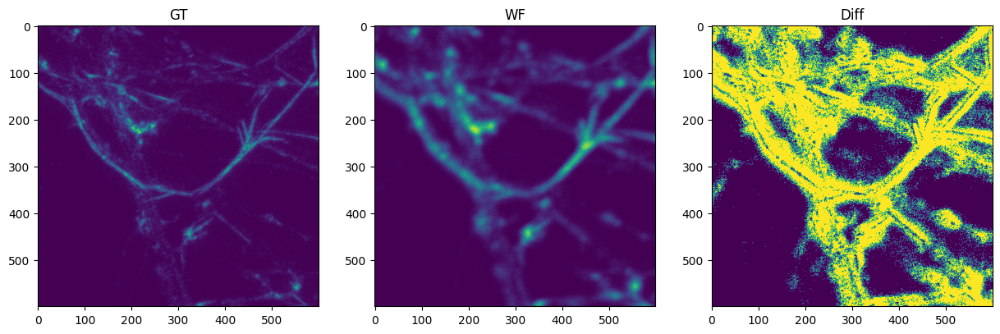

2020-09-10_EXP0_CONFSTEDfull17_10.tif
GT - shape (810, 381) min 0 max 51
WF - shape (810, 381) min 0 max 186
Diff - shape (810, 381) min 0 max 65535


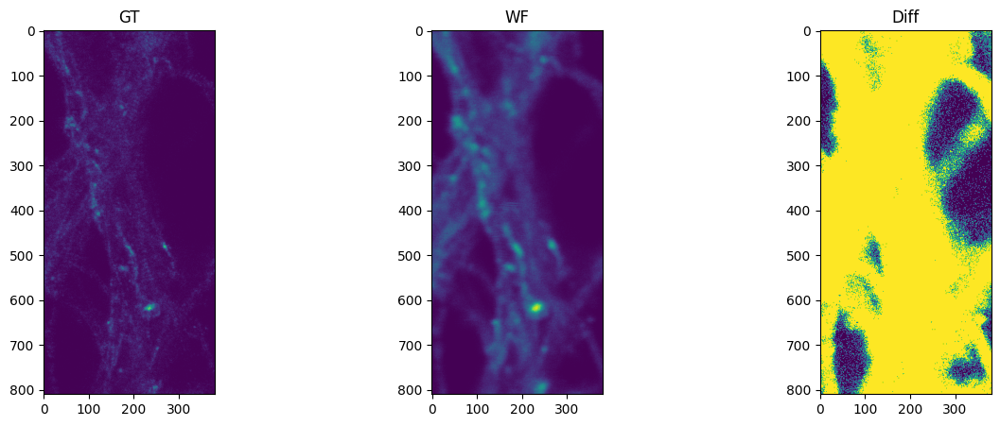

2020-09-10_EXP0_CONFSTEDfull17_11.tif
GT - shape (552, 444) min 0 max 18
WF - shape (552, 444) min 0 max 58
Diff - shape (552, 444) min 0 max 65535


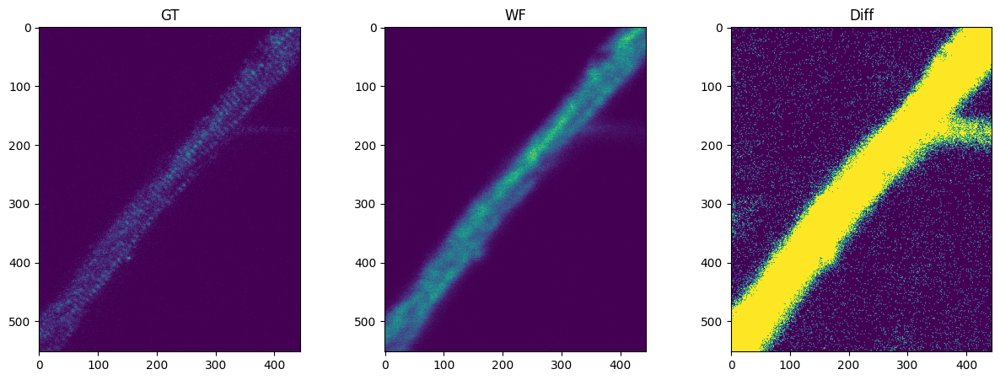

2020-09-10_EXP0_CONFSTEDfull17_7.tif
GT - shape (429, 513) min 0 max 38
WF - shape (429, 513) min 0 max 152
Diff - shape (429, 513) min 0 max 65535


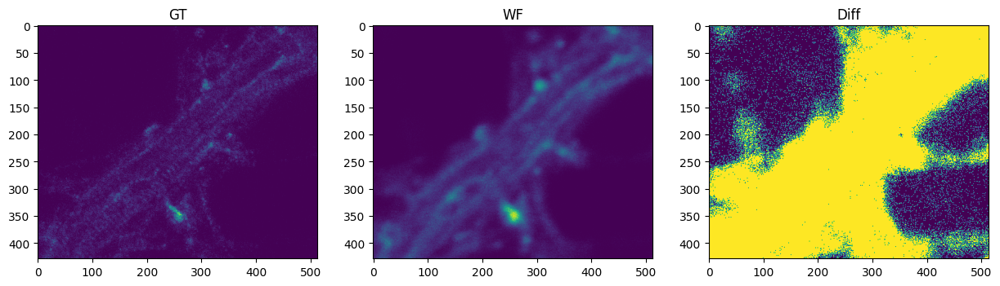

2020-09-10_EXP0_CONFSTEDfull17_9.tif
GT - shape (537, 747) min 0 max 65
WF - shape (537, 747) min 0 max 191
Diff - shape (537, 747) min 0 max 65535


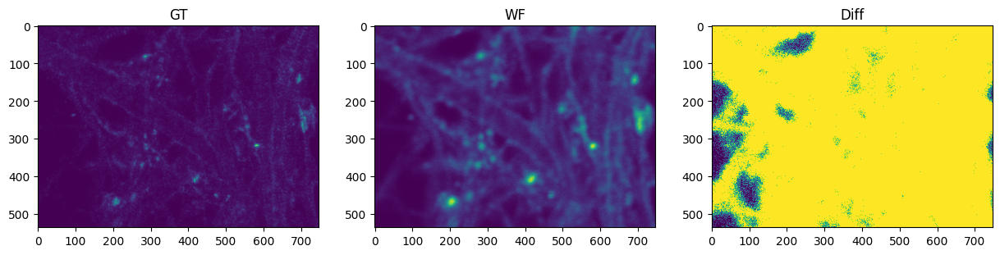

2020-09-10_EXP0_CONFSTEDfull_0.tif
GT - shape (759, 1551) min 0 max 129
WF - shape (759, 1551) min 0 max 211
Diff - shape (759, 1551) min 0 max 65535


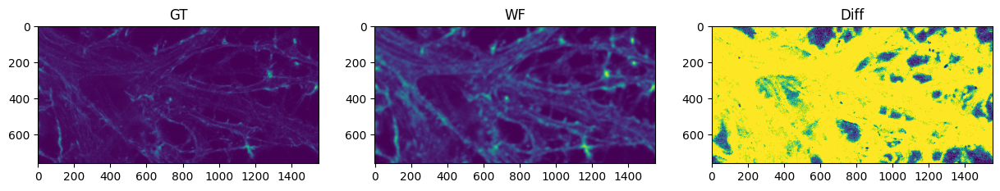

2020-09-10_EXP0_CONFSTEDfull_1.tif
GT - shape (600, 900) min 0 max 162
WF - shape (600, 900) min 0 max 216
Diff - shape (600, 900) min 0 max 65535


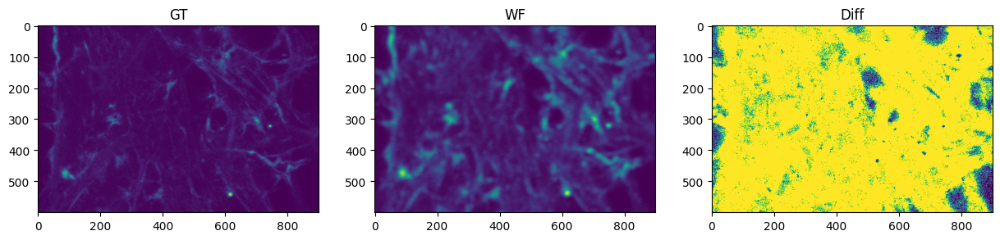

2020-09-10_EXP0_CONFSTEDfull_2.tif
GT - shape (849, 699) min 0 max 158
WF - shape (849, 699) min 0 max 200
Diff - shape (849, 699) min 0 max 65535


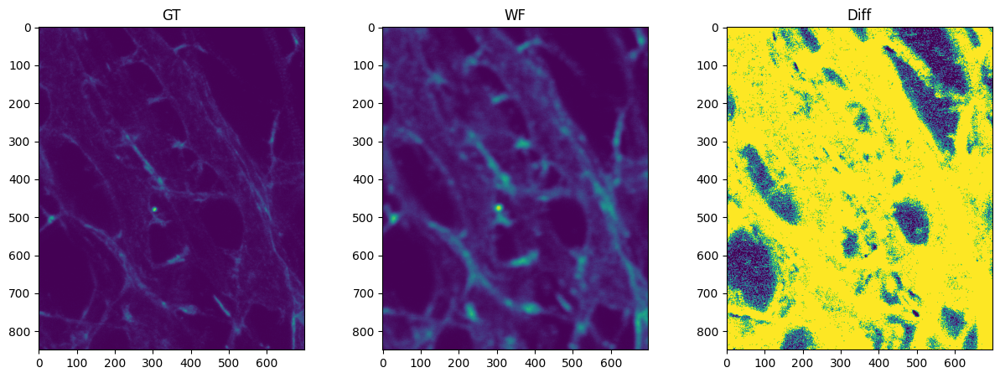

2020-09-10_EXP0_CONFSTEDfull_3.tif
GT - shape (1260, 555) min 0 max 90
WF - shape (1260, 555) min 0 max 145
Diff - shape (1260, 555) min 0 max 65535


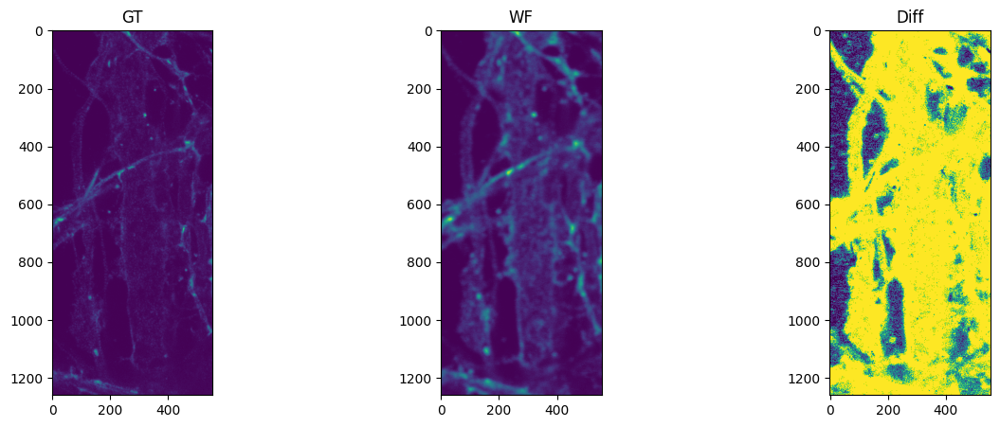

2020-09-10_EXP0_CONFSTEDfull_4.tif
GT - shape (756, 1153) min 0 max 149
WF - shape (756, 1153) min 0 max 238
Diff - shape (756, 1153) min 0 max 65535


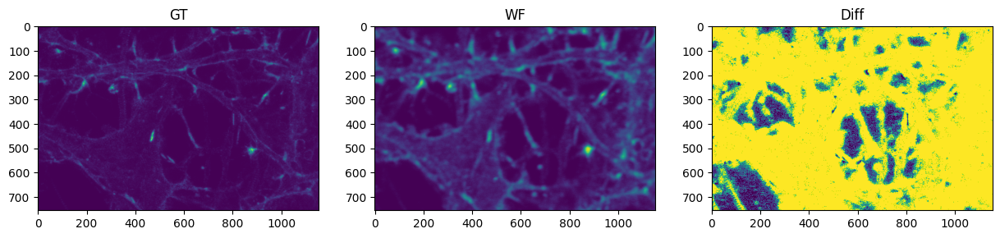

2020-09-29_Actin_livecs3_02_ROI1_1.msr.tif
GT - shape (767, 477) min 0 max 88
WF - shape (767, 477) min 0 max 255
Diff - shape (767, 477) min 0 max 65535


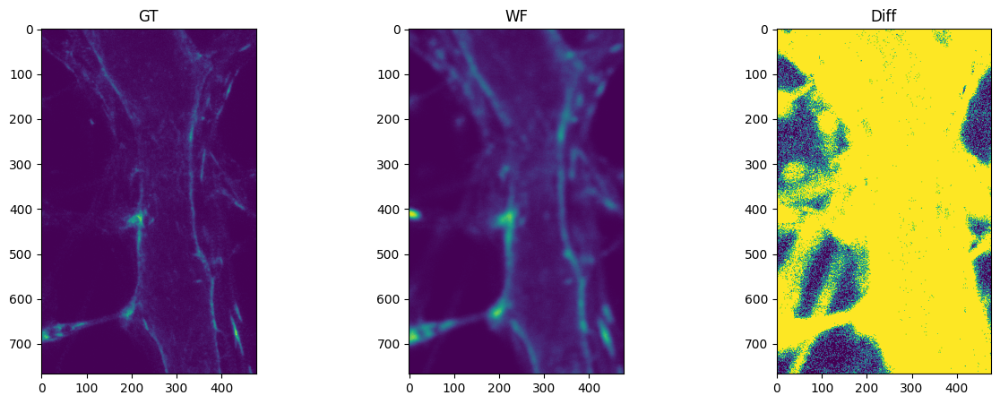

2020-09-29_Actin_livecs3_02_ROI2_1.msr.tif
GT - shape (715, 550) min 0 max 85
WF - shape (715, 550) min 0 max 191
Diff - shape (715, 550) min 0 max 65535


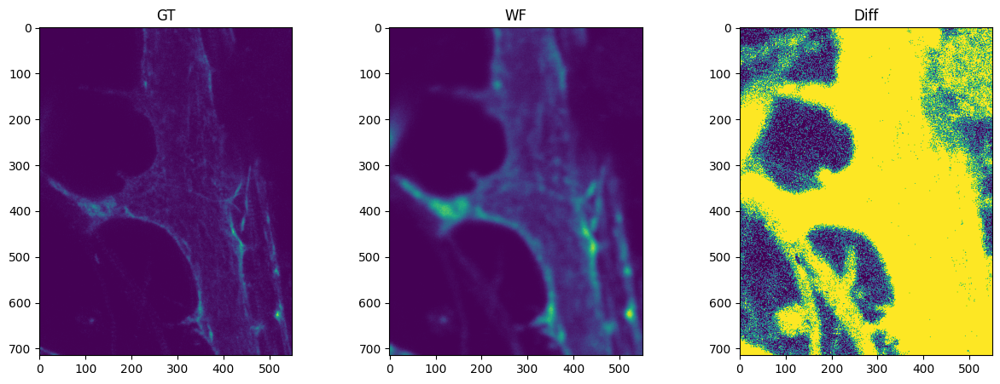

2020-09-29_Actin_livecs3_02_ROI3_1.msr.tif
GT - shape (700, 537) min 0 max 124
WF - shape (700, 537) min 0 max 252
Diff - shape (700, 537) min 0 max 65535


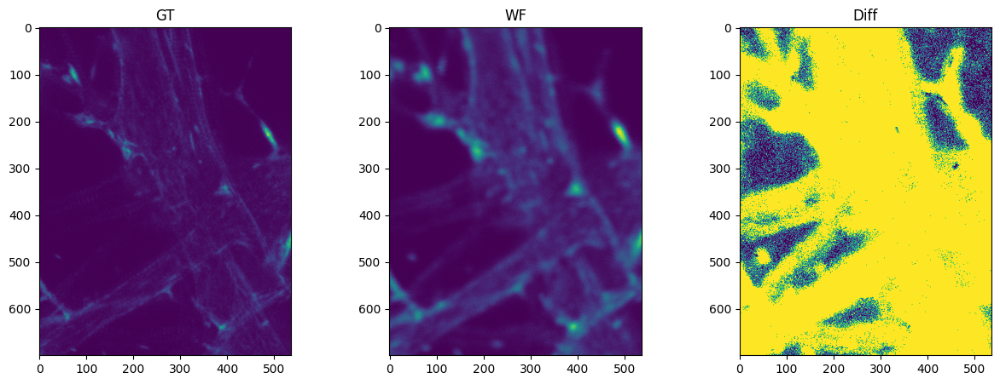

2020-09-29_Actin_livecs3_02_ROI4_1.msr.tif
GT - shape (822, 757) min 0 max 132
WF - shape (822, 757) min 0 max 241
Diff - shape (822, 757) min 0 max 65535


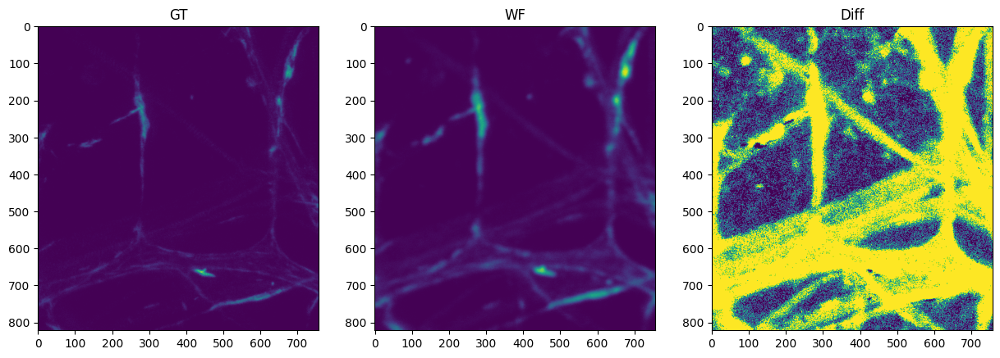

2020-09-29_Actin_livecs3_03_ROI1_1.msr.tif
GT - shape (380, 615) min 0 max 47
WF - shape (380, 615) min 0 max 144
Diff - shape (380, 615) min 0 max 65535


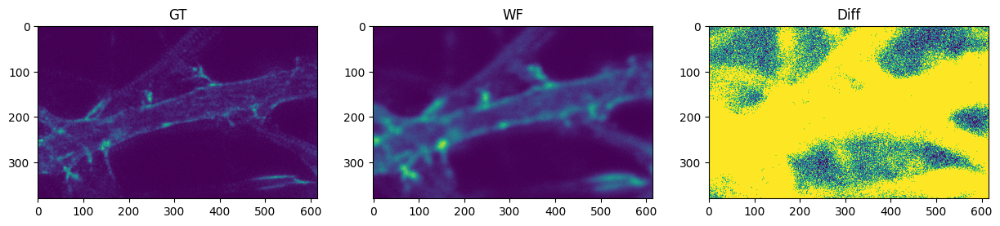

2020-09-29_Actin_livecs3_03_ROI2_1.msr.tif
GT - shape (605, 570) min 0 max 82
WF - shape (605, 570) min 0 max 190
Diff - shape (605, 570) min 0 max 65535


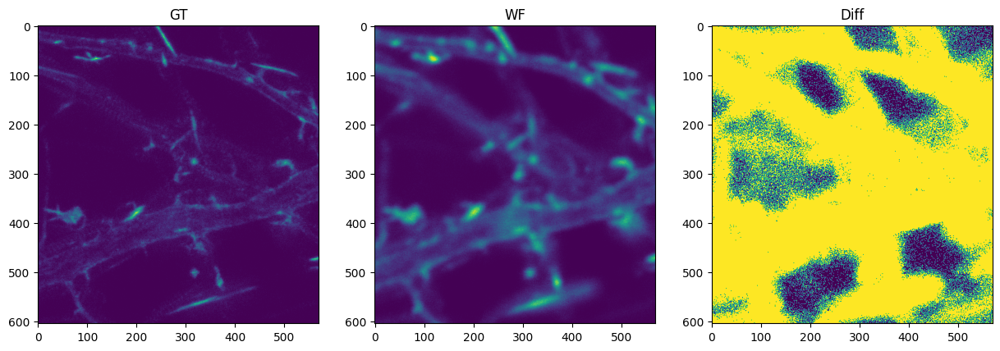

2020-09-29_Actin_livecs3_03_ROI4_1.msr.tif
GT - shape (407, 307) min 0 max 72
WF - shape (407, 307) min 0 max 167
Diff - shape (407, 307) min 0 max 65535


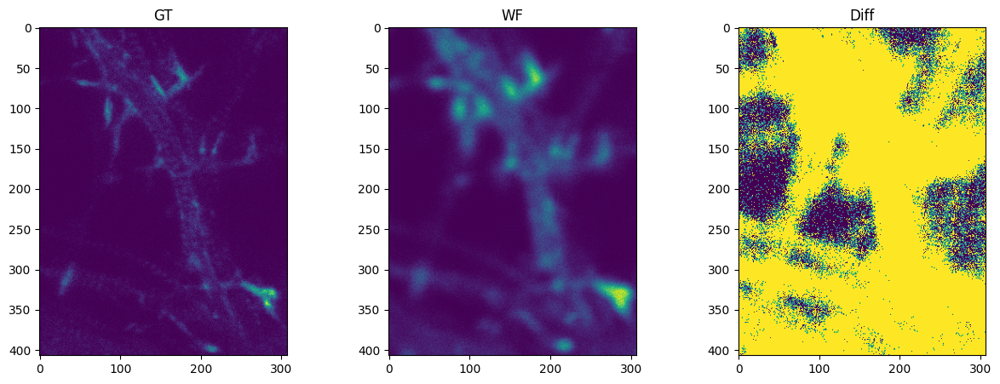

2020-09-29_Actin_livecs3_04_ROI1_1.msr.tif
GT - shape (795, 525) min 0 max 59
WF - shape (795, 525) min 0 max 154
Diff - shape (795, 525) min 0 max 65535


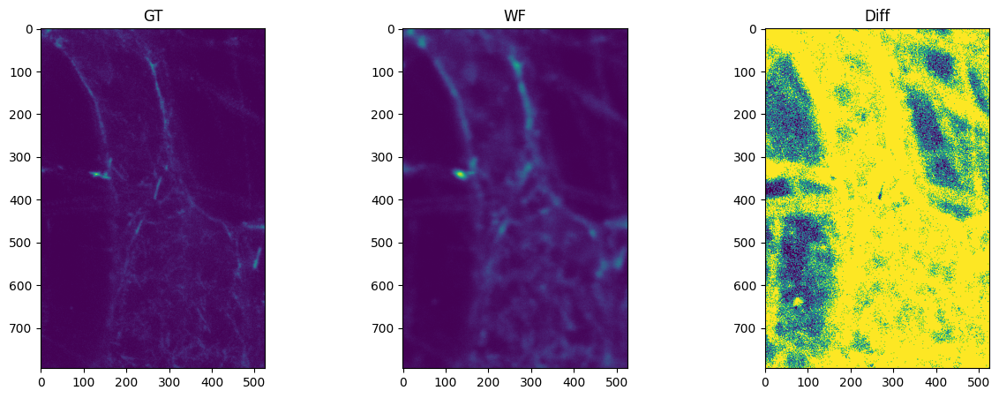

2020-09-29_Actin_livecs3_04_ROI2_1.msr.tif
GT - shape (762, 565) min 0 max 114
WF - shape (762, 565) min 0 max 200
Diff - shape (762, 565) min 0 max 65535


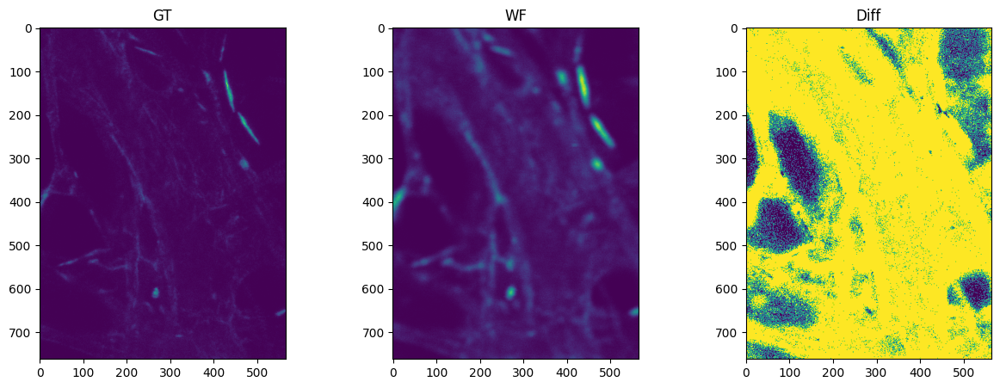

2020-09-29_Actin_livecs3_04_ROI3_1.msr.tif
GT - shape (820, 422) min 0 max 100
WF - shape (820, 422) min 0 max 171
Diff - shape (820, 422) min 0 max 65535


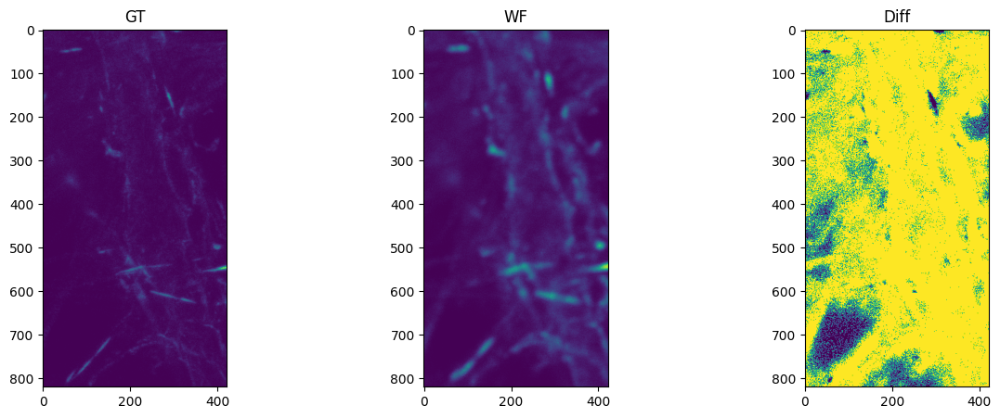

2020-09-29_Actin_livecs3_04_ROI4_1.msr.tif
GT - shape (1475, 375) min 0 max 161
WF - shape (1475, 375) min 0 max 293
Diff - shape (1475, 375) min 0 max 65535


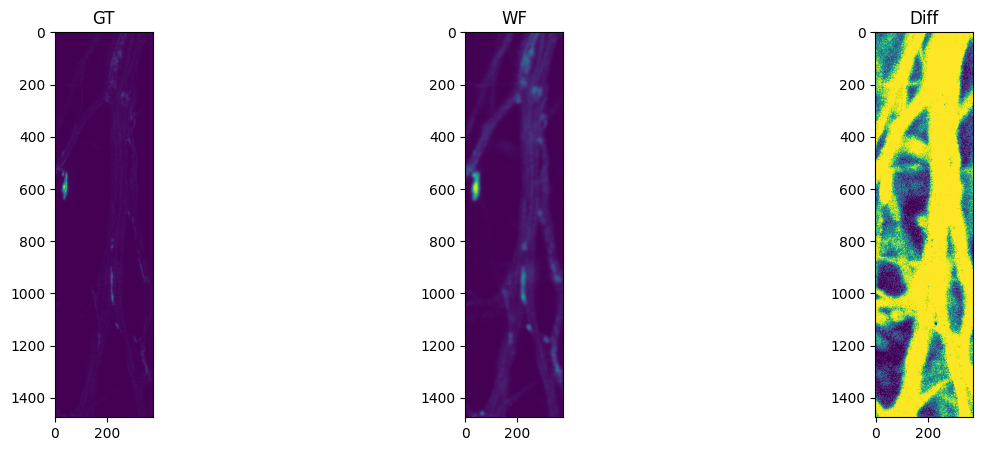

2020-09-29_Actin_livecs3_05_ROI1_1.msr.tif
GT - shape (645, 505) min 0 max 82
WF - shape (645, 505) min 0 max 194
Diff - shape (645, 505) min 0 max 65535


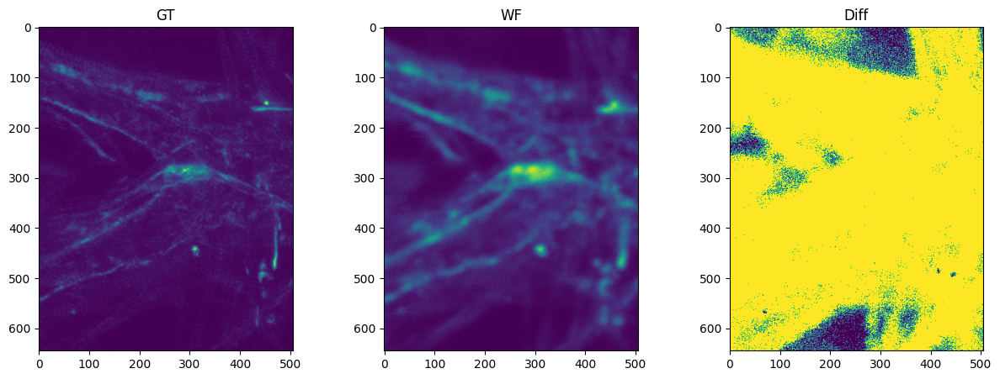

2020-09-29_Actin_livecs3_05_ROI2_1.msr.tif
GT - shape (437, 597) min 0 max 83
WF - shape (437, 597) min 0 max 168
Diff - shape (437, 597) min 0 max 65535


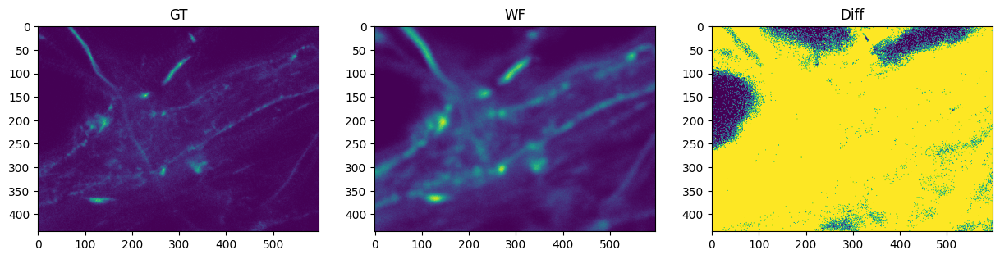

2020-09-29_Actin_livecs3_05_ROI3_1.msr.tif
GT - shape (467, 1200) min 0 max 163
WF - shape (467, 1200) min 0 max 254
Diff - shape (467, 1200) min 0 max 65535


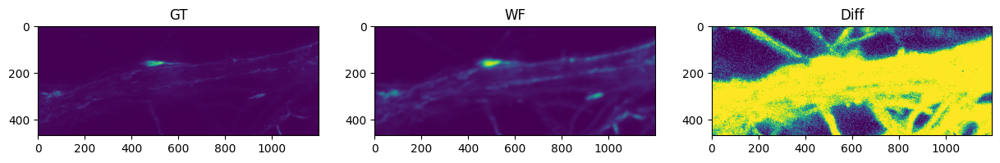

2020-09-29_Actin_livecs3_05_ROI4_1.msr.tif
GT - shape (370, 355) min 0 max 68
WF - shape (370, 355) min 0 max 149
Diff - shape (370, 355) min 0 max 65535


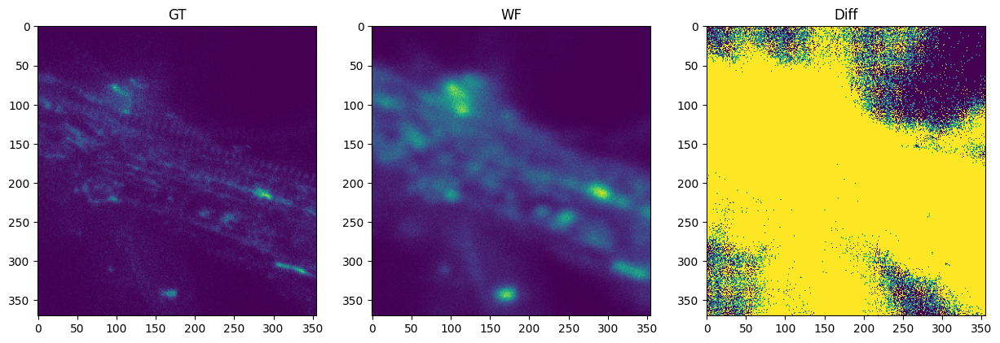

2020-09-29_Actin_livecs3_05_ROI5_1.msr.tif
GT - shape (457, 665) min 0 max 198
WF - shape (457, 665) min 0 max 300
Diff - shape (457, 665) min 0 max 65535


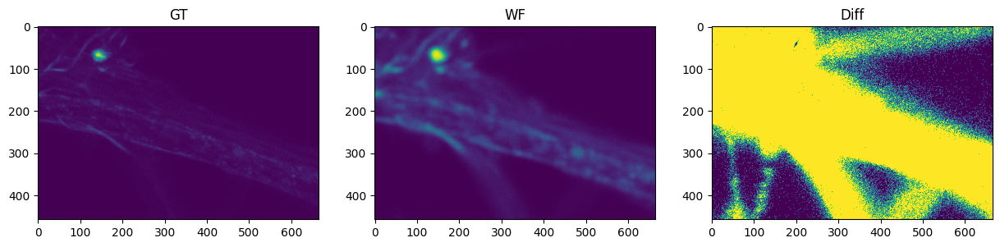

2020-09-29_Actin_livecs3_05_ROI6_1.msr.tif
GT - shape (272, 807) min 0 max 108
WF - shape (272, 807) min 0 max 226
Diff - shape (272, 807) min 0 max 65535


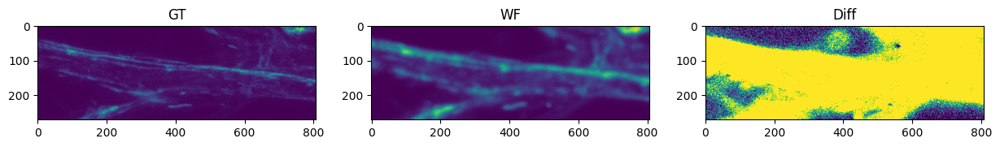

Actin_live_testActin_SiR_Catherine_cs2_7_STEDimages__ROI5_0.msr.tif
GT - shape (259, 347) min 0 max 14
WF - shape (259, 347) min 0 max 54
Diff - shape (259, 347) min 0 max 65535


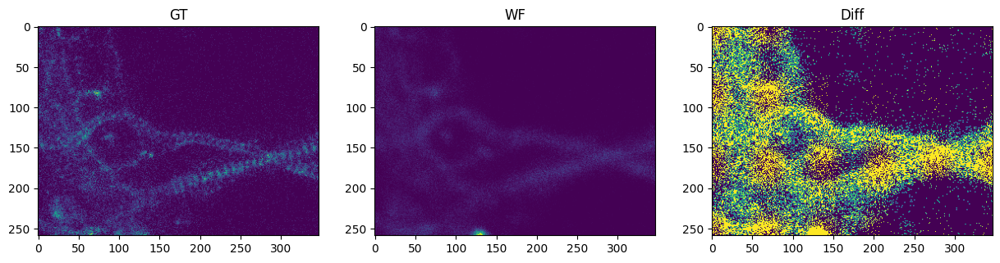

Actin_live_testActin_SiR_Catherine_cs2_9_STEDimages__ROI1_0.msr.tif
GT - shape (325, 314) min 0 max 77
WF - shape (325, 314) min 0 max 66
Diff - shape (325, 314) min 0 max 65535


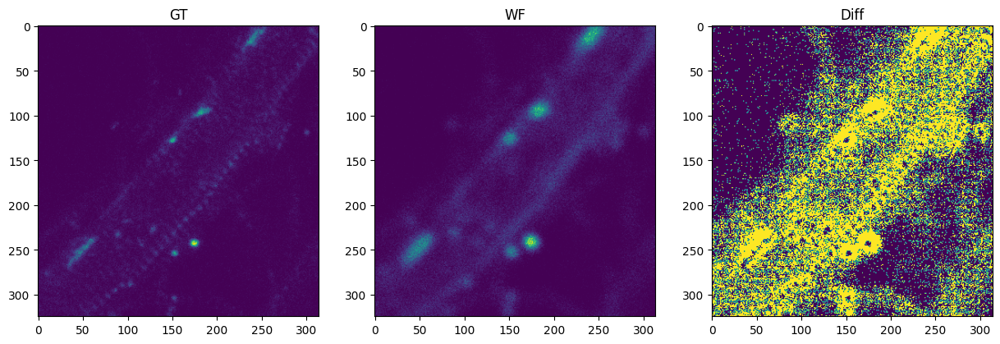

Actin_live_testActin_SiR_Catherine_cs2_9_STEDimages__ROI5_0.msr.tif
GT - shape (336, 259) min 0 max 56
WF - shape (336, 259) min 0 max 74
Diff - shape (336, 259) min 0 max 65535


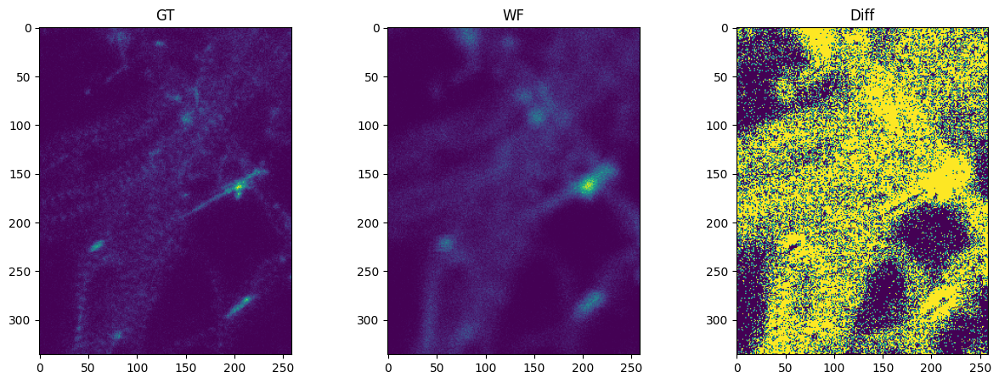

Actin_live_testActin_SiR_Catherine_cs2_9_STEDimages__ROI6_0.msr.tif
GT - shape (270, 435) min 0 max 67
WF - shape (270, 435) min 0 max 92
Diff - shape (270, 435) min 0 max 65535


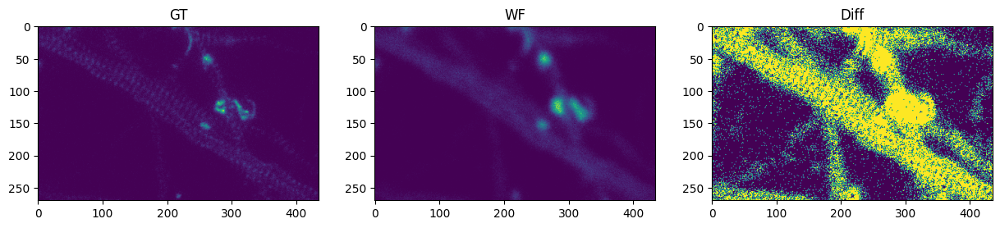

Actin_live_testActin_SiR_Catherine_cs2_9_STEDimages__ROI7_0.msr.tif
GT - shape (314, 347) min 0 max 139
WF - shape (314, 347) min 0 max 111
Diff - shape (314, 347) min 0 max 65535


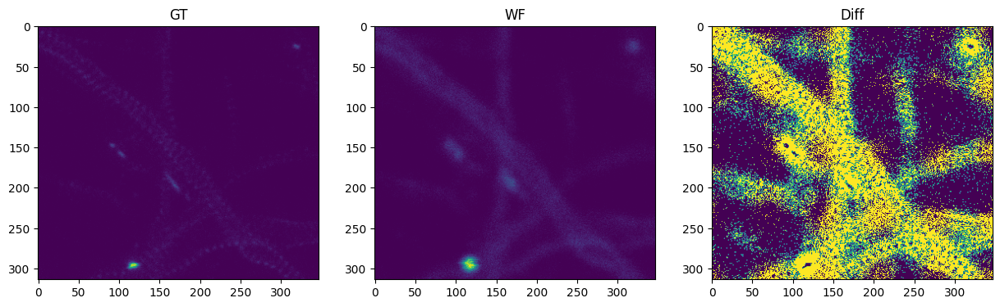

paired_Actin_live_testcs6_c1_1_ROI1_0.tif
GT - shape (385, 440) min 0 max 56
WF - shape (385, 440) min 0 max 56
Diff - shape (385, 440) min 0 max 65535


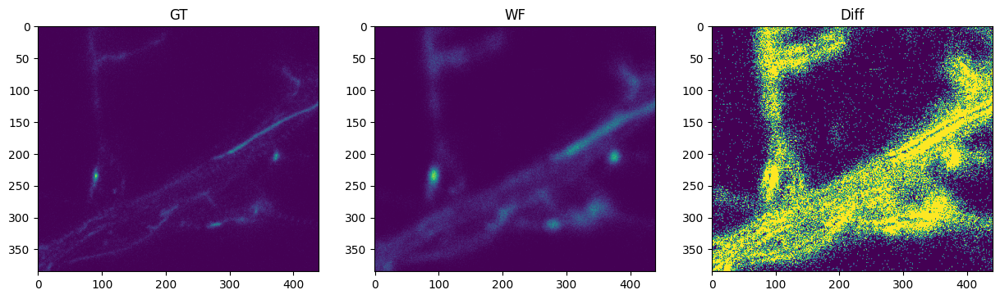

paired_Actin_live_testcs6_c1_1_ROI2_0.tif
GT - shape (556, 875) min 0 max 76
WF - shape (556, 875) min 0 max 90
Diff - shape (556, 875) min 0 max 65535


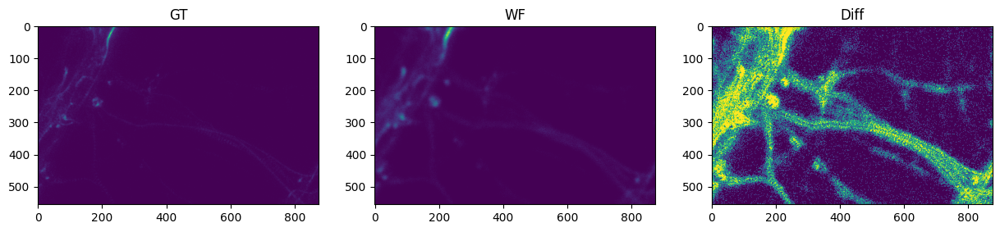

paired_Actin_live_testcs6_c1_1_ROI3_0.tif
GT - shape (479, 649) min 0 max 37
WF - shape (479, 649) min 0 max 41
Diff - shape (479, 649) min 0 max 65535


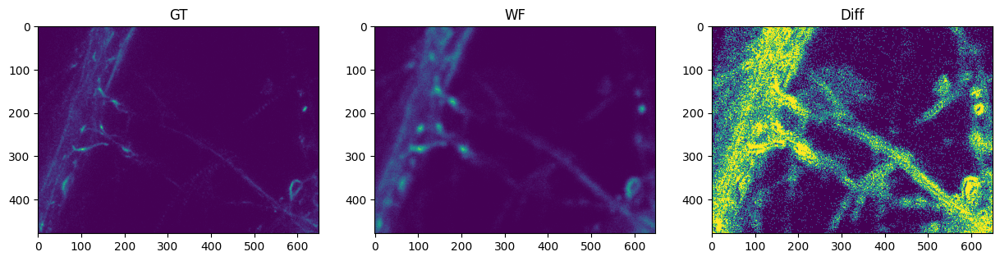

paired_Actin_live_testcs6_c1_1_ROI4_0.tif
GT - shape (347, 495) min 0 max 28
WF - shape (347, 495) min 0 max 37
Diff - shape (347, 495) min 0 max 65535


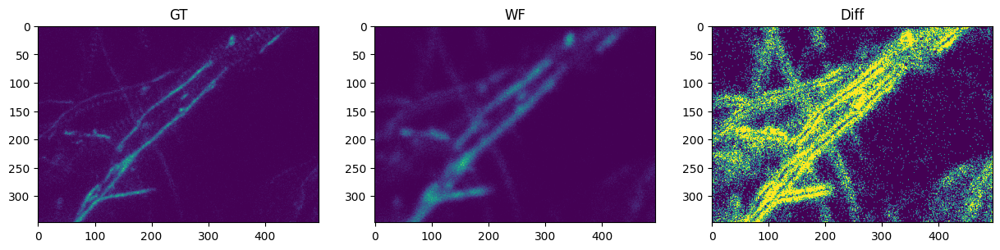

paired_Actin_live_testcs6_c1_1_ROI5_0.tif
GT - shape (325, 556) min 0 max 21
WF - shape (325, 556) min 0 max 24
Diff - shape (325, 556) min 0 max 65535


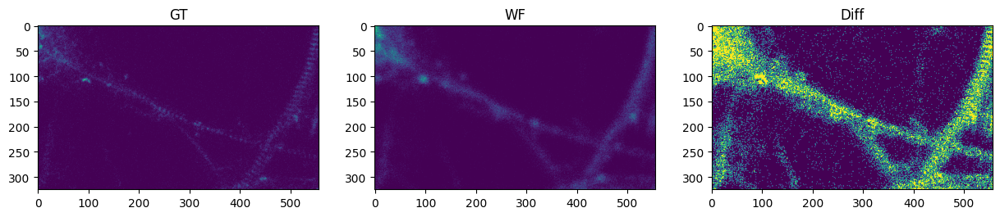

paired_Actin_live_testcs6_c2_1_ROI1_0.tif
GT - shape (831, 792) min 0 max 48
WF - shape (831, 792) min 0 max 46
Diff - shape (831, 792) min 0 max 65535


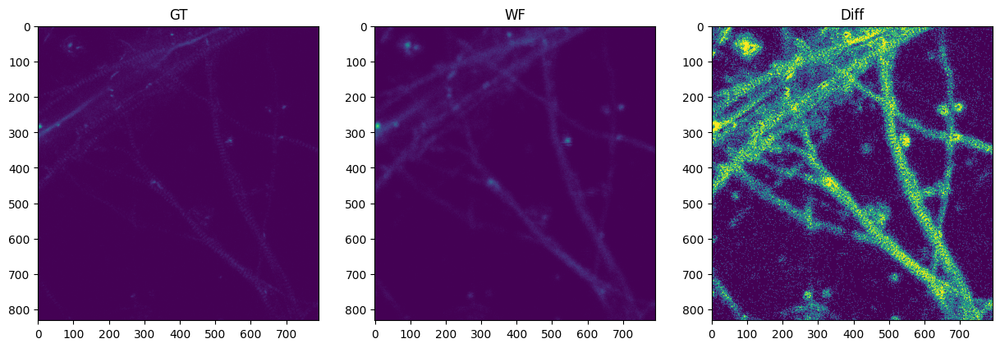

paired_Actin_live_testcs6_c2_1_ROI2_0.tif
GT - shape (358, 935) min 0 max 44
WF - shape (358, 935) min 0 max 34
Diff - shape (358, 935) min 0 max 65535


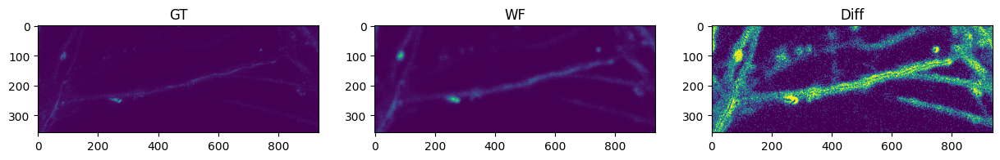

paired_Actin_live_testcs6_c2_1_ROI3_0.tif
GT - shape (374, 545) min 0 max 25
WF - shape (374, 545) min 0 max 32
Diff - shape (374, 545) min 0 max 65535


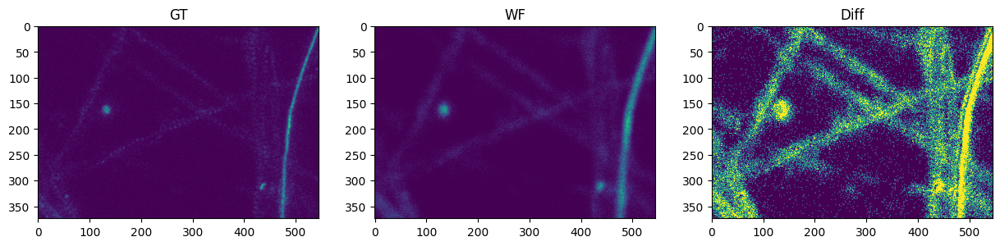

paired_Actin_live_testcs6_c2_1_ROI5_0.tif
GT - shape (451, 407) min 0 max 40
WF - shape (451, 407) min 0 max 42
Diff - shape (451, 407) min 0 max 65535


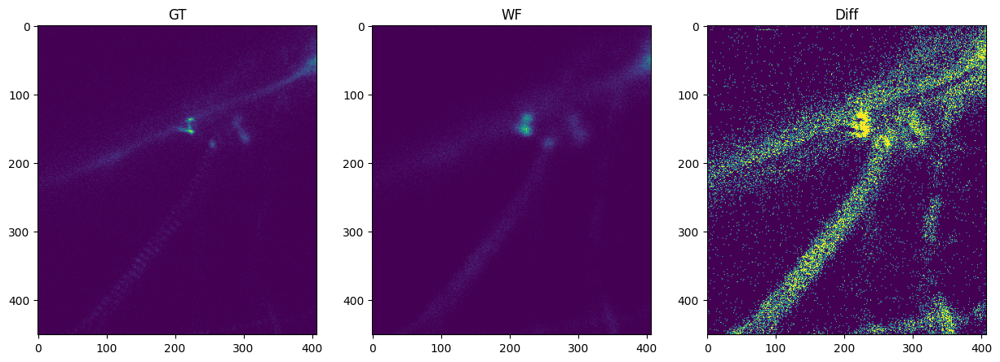

paired_Actin_live_testcs6_c3_1_ROI4_0.tif
GT - shape (270, 424) min 0 max 42
WF - shape (270, 424) min 0 max 44
Diff - shape (270, 424) min 0 max 65535


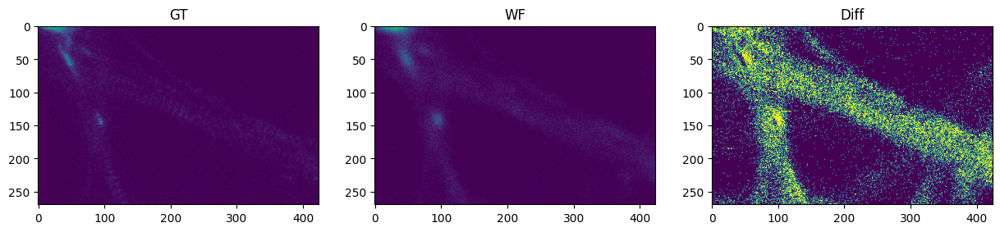

In [47]:
for img_name in sorted(os.listdir('../datasets/LiveFActinDataset/val_split/gt')):
    print(img_name)
    base_gt_img = io.imread(os.path.join('../datasets/LiveFActinDataset/val_split/gt', img_name))
    base_wf_img = io.imread(os.path.join('../datasets/LiveFActinDataset/val_split/wf', img_name))
    diff = base_gt_img - base_wf_img
    print(f'GT - shape {base_gt_img.shape} min {base_gt_img.min()} max {base_gt_img.max()}')
    print(f'WF - shape {base_wf_img.shape} min {base_wf_img.min()} max {base_wf_img.max()}')
    print(f'Diff - shape {diff.shape} min {diff.min()} max {diff.max()}')
    plt.figure(figsize=(15,5))
    plt.subplot(1, 3, 1)
    plt.imshow(base_gt_img)
    plt.title('GT')
    plt.subplot(1, 3, 2)
    plt.imshow(base_wf_img)
    plt.title('WF')
    plt.subplot(1, 3, 3)
    plt.imshow(diff)
    plt.title('Diff')
    plt.show()

datasets.py - read_image -> filename: ../datasets/LiveFActinDataset/train_split/gt/2020-09-10_EXP0_CONFSTEDfull13_8.tif
datasets.py - normalization -> data: (630, 300) datatype: uint16 datamin: 0 datamax: 62
datasets.py - normalization -> norm_data: (630, 300) datatype: float32 datamin: 0.0 datamax: 1.0
datasets.py - read_image -> read_img: (630, 300) datatype: float32 datamin: 0.0 datamax: 1.0
datasets.py - read_image -> filename: ../datasets/LiveFActinDataset/train_split/wf/2020-09-10_EXP0_CONFSTEDfull13_8.tif
datasets.py - normalization -> data: (630, 300) datatype: uint16 datamin: 0 datamax: 207
datasets.py - normalization -> norm_data: (630, 300) datatype: float32 datamin: 0.0 datamax: 1.0
datasets.py - read_image -> read_img: (630, 300) datatype: float32 datamin: 0.0 datamax: 1.0


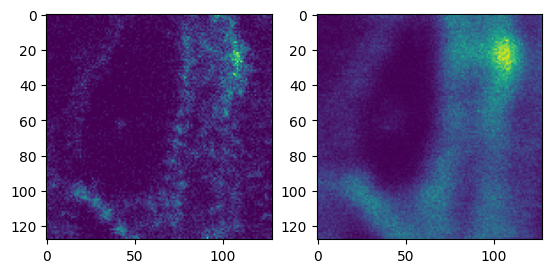

datasets.py - read_image -> filename: ../datasets/LiveFActinDataset/train_split/gt/2020-09-10_EXP0_CONFSTEDfull14_1.tif
datasets.py - normalization -> data: (756, 513) datatype: uint16 datamin: 0 datamax: 33
datasets.py - normalization -> norm_data: (756, 513) datatype: float32 datamin: 0.0 datamax: 1.0
datasets.py - read_image -> read_img: (756, 513) datatype: float32 datamin: 0.0 datamax: 1.0
datasets.py - read_image -> filename: ../datasets/LiveFActinDataset/train_split/wf/2020-09-10_EXP0_CONFSTEDfull14_1.tif
datasets.py - normalization -> data: (756, 513) datatype: uint16 datamin: 0 datamax: 80
datasets.py - normalization -> norm_data: (756, 513) datatype: float32 datamin: 0.0 datamax: 1.0
datasets.py - read_image -> read_img: (756, 513) datatype: float32 datamin: 0.0 datamax: 1.0


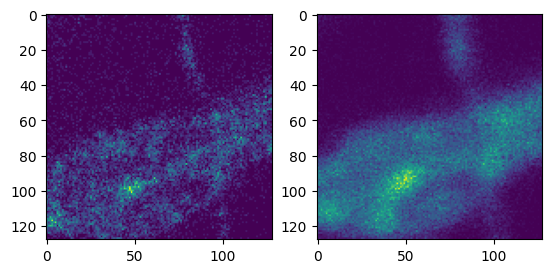

datasets.py - read_image -> filename: ../datasets/LiveFActinDataset/train_split/gt/2020-09-10_EXP0_CONFSTEDfull14_2.tif
datasets.py - normalization -> data: (714, 675) datatype: uint16 datamin: 0 datamax: 59
datasets.py - normalization -> norm_data: (714, 675) datatype: float32 datamin: 0.0 datamax: 1.0
datasets.py - read_image -> read_img: (714, 675) datatype: float32 datamin: 0.0 datamax: 1.0
datasets.py - read_image -> filename: ../datasets/LiveFActinDataset/train_split/wf/2020-09-10_EXP0_CONFSTEDfull14_2.tif
datasets.py - normalization -> data: (714, 675) datatype: uint16 datamin: 0 datamax: 180
datasets.py - normalization -> norm_data: (714, 675) datatype: float32 datamin: 0.0 datamax: 1.0
datasets.py - read_image -> read_img: (714, 675) datatype: float32 datamin: 0.0 datamax: 1.0


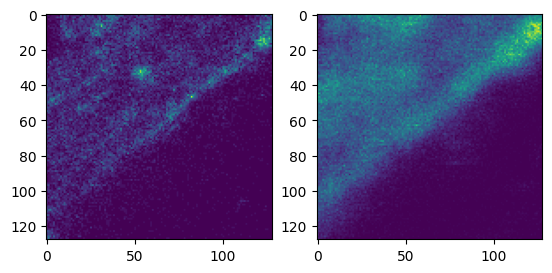

datasets.py - read_image -> filename: ../datasets/LiveFActinDataset/train_split/gt/2020-09-10_EXP0_CONFSTEDfull14_3.tif
datasets.py - normalization -> data: (516, 681) datatype: uint16 datamin: 0 datamax: 59
datasets.py - normalization -> norm_data: (516, 681) datatype: float32 datamin: 0.0 datamax: 1.0
datasets.py - read_image -> read_img: (516, 681) datatype: float32 datamin: 0.0 datamax: 1.0
datasets.py - read_image -> filename: ../datasets/LiveFActinDataset/train_split/wf/2020-09-10_EXP0_CONFSTEDfull14_3.tif
datasets.py - normalization -> data: (516, 681) datatype: uint16 datamin: 0 datamax: 181
datasets.py - normalization -> norm_data: (516, 681) datatype: float32 datamin: 0.0 datamax: 1.0
datasets.py - read_image -> read_img: (516, 681) datatype: float32 datamin: 0.0 datamax: 1.0


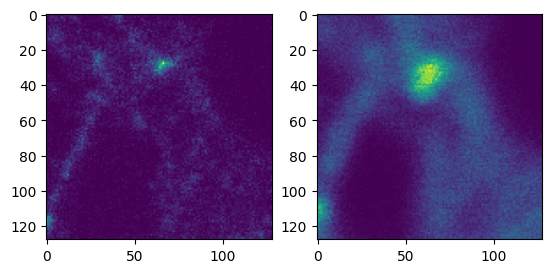

In [48]:

def normalization(data, desired_accuracy=np.float32):
    print(f'datasets.py - normalization -> data: {data.shape} datatype: {data.dtype} datamin: {data.min()} datamax: {data.max()}' )
    norm_data =  (data - data.min()) / (data.max() - data.min() + 1e-10).astype(desired_accuracy)
    print(f'datasets.py - normalization -> norm_data: {norm_data.shape} datatype: {norm_data.dtype} datamin: {norm_data.min()} datamax: {norm_data.max()}' )
    return norm_data

def read_image(filename, desired_accuracy=np.float32):
    print(f'datasets.py - read_image -> filename: {filename}' )
    read_img = normalization(io.imread(filename), desired_accuracy=desired_accuracy)
    print(f'datasets.py - read_image -> read_img: {read_img.shape} datatype: {read_img.dtype} datamin: {read_img.min()} datamax: {read_img.max()}' )
    return read_img

# datasets.py - TFDataGenerator.__getitem__ -> START
# datasets.py - read_image -> filename: ../datasets/LiveFActinDataset/train_split/gt/2020-09-10_EXP0_CONFSTEDfull13_8.tif
# datasets.py - normalization -> data: (630, 300) datatype: uint16 datamin: 0 datamax: 62
# datasets.py - normalization -> norm_data: (630, 300) datatype: float32 datamin: 0.0 datamax: 1.0
# datasets.py - read_image -> read_img: (630, 300) datatype: float32 datamin: 0.0 datamax: 1.0
# datasets.py - read_image_pairs -> Path to the LR images is given.
# datasets.py - read_image -> filename: ../datasets/LiveFActinDataset/train_split/wf/2020-09-10_EXP0_CONFSTEDfull13_8.tif
# datasets.py - normalization -> data: (630, 300) datatype: uint16 datamin: 0 datamax: 207
# datasets.py - normalization -> norm_data: (630, 300) datatype: float32 datamin: 0.0 datamax: 1.0
# datasets.py - read_image -> read_img: (630, 300) datatype: float32 datamin: 0.0 datamax: 1.0
# datasets.py - read_image_pairs -> hr_img: (630, 300) lr_img: (630, 300)
# datasets.py - sampling_pdf -> custom sampling (based on a pdf)
# NORMALIZACITION OF THE PDF
    # datasets.py - normalization -> data: (630, 300) datatype: float64 datamin: 30.33816394302975 datamax: 2443.8599006994627 
    # datasets.py - normalization -> norm_data: (630, 300) datatype: float64 datamin: 0.0 datamax: 1.0000000034144327
# datasets.py - index_from_pdf -> indexh: 180, indexw: 81
# datasets.py - sampling_pdf -> indexh: 244, indexw: 145
# datasets.py - extract_random_patches_from_image -> lr_patch: (128, 128) hr_patch: (128, 128)
# datasets.py - TFDataGenerator.__getitem__ -> LR.shape (128, 128, 1), HR.shape (128, 128, 1)
# datasets.py - TFDataGenerator.__getitem__ -> END

gt_img_1 = read_image('../datasets/LiveFActinDataset/train_split/gt/2020-09-10_EXP0_CONFSTEDfull13_8.tif')
wf_img_1 = read_image('../datasets/LiveFActinDataset/train_split/wf/2020-09-10_EXP0_CONFSTEDfull13_8.tif')

indexh = 244
indexw = 145

plt.subplot(1,2,1)
plt.imshow(gt_img_1[indexh-64:indexh+64, indexw-64:indexw+64])
plt.subplot(1,2,2)
plt.imshow(wf_img_1[indexh-64:indexh+64, indexw-64:indexw+64])
plt.show()

# datasets.py - TFDataGenerator.__getitem__ -> START
# datasets.py - read_image -> filename: ../datasets/LiveFActinDataset/train_split/gt/2020-09-10_EXP0_CONFSTEDfull14_1.tif
# datasets.py - normalization -> data: (756, 513) datatype: uint16 datamin: 0 datamax: 33
# datasets.py - normalization -> norm_data: (756, 513) datatype: float32 datamin: 0.0 datamax: 1.0
# datasets.py - read_image -> read_img: (756, 513) datatype: float32 datamin: 0.0 datamax: 1.0
# datasets.py - read_image_pairs -> Path to the LR images is given.
# datasets.py - read_image -> filename: ../datasets/LiveFActinDataset/train_split/wf/2020-09-10_EXP0_CONFSTEDfull14_1.tif
# datasets.py - normalization -> data: (756, 513) datatype: uint16 datamin: 0 datamax: 80
# datasets.py - normalization -> norm_data: (756, 513) datatype: float32 datamin: 0.0 datamax: 1.0
# datasets.py - read_image -> read_img: (756, 513) datatype: float32 datamin: 0.0 datamax: 1.0
# datasets.py - read_image_pairs -> hr_img: (756, 513) lr_img: (756, 513)
# datasets.py - sampling_pdf -> custom sampling (based on a pdf)
# datasets.py - normalization -> data: (756, 512) datatype: float64 datamin: 6.943900809048216 datamax: 2868.283906806544
# datasets.py - normalization -> norm_data: (756, 512) datatype: float64 datamin: 0.0 datamax: 0.9999999713794493
# datasets.py - index_from_pdf -> indexh: 572, indexw: 126
# datasets.py - sampling_pdf -> indexh: 636, indexw: 190
# datasets.py - extract_random_patches_from_image -> lr_patch: (128, 128) hr_patch: (128, 128)
# datasets.py - TFDataGenerator.__getitem__ -> LR.shape (128, 128, 1), HR.shape (128, 128, 1)
# datasets.py - TFDataGenerator.__getitem__ -> END


gt_img_1 = read_image('../datasets/LiveFActinDataset/train_split/gt/2020-09-10_EXP0_CONFSTEDfull14_1.tif')
wf_img_1 = read_image('../datasets/LiveFActinDataset/train_split/wf/2020-09-10_EXP0_CONFSTEDfull14_1.tif')

indexh = 636
indexw = 190

plt.subplot(1,2,1)
plt.imshow(gt_img_1[indexh-64:indexh+64, indexw-64:indexw+64])
plt.subplot(1,2,2)
plt.imshow(wf_img_1[indexh-64:indexh+64, indexw-64:indexw+64])
plt.show()

# datasets.py - TFDataGenerator.__getitem__ -> START
# datasets.py - read_image -> filename: ../datasets/LiveFActinDataset/train_split/gt/2020-09-10_EXP0_CONFSTEDfull14_2.tif
# datasets.py - normalization -> data: (714, 675) datatype: uint16 datamin: 0 datamax: 59
# datasets.py - normalization -> norm_data: (714, 675) datatype: float32 datamin: 0.0 datamax: 1.0
# datasets.py - read_image -> read_img: (714, 675) datatype: float32 datamin: 0.0 datamax: 1.0
# datasets.py - read_image_pairs -> Path to the LR images is given.
# datasets.py - read_image -> filename: ../datasets/LiveFActinDataset/train_split/wf/2020-09-10_EXP0_CONFSTEDfull14_2.tif
# datasets.py - normalization -> data: (714, 675) datatype: uint16 datamin: 0 datamax: 180
# datasets.py - normalization -> norm_data: (714, 675) datatype: float32 datamin: 0.0 datamax: 1.0
# datasets.py - read_image -> read_img: (714, 675) datatype: float32 datamin: 0.0 datamax: 1.0
# datasets.py - read_image_pairs -> hr_img: (714, 675) lr_img: (714, 675)
# datasets.py - sampling_pdf -> custom sampling (based on a pdf)
# datasets.py - normalization -> data: (714, 674) datatype: float64 datamin: 4.914614236878056 datamax: 2175.9965697775942
# datasets.py - normalization -> norm_data: (714, 674) datatype: float64 datamin: 0.0 datamax: 0.9999999651283172
# datasets.py - index_from_pdf -> indexh: 307, indexw: 262
# datasets.py - sampling_pdf -> indexh: 371, indexw: 326
# datasets.py - extract_random_patches_from_image -> lr_patch: (128, 128) hr_patch: (128, 128)
# datasets.py - TFDataGenerator.__getitem__ -> LR.shape (128, 128, 1), HR.shape (128, 128, 1)
# datasets.py - TFDataGenerator.__getitem__ -> END

gt_img_1 = read_image('../datasets/LiveFActinDataset/train_split/gt/2020-09-10_EXP0_CONFSTEDfull14_2.tif')
wf_img_1 = read_image('../datasets/LiveFActinDataset/train_split/wf/2020-09-10_EXP0_CONFSTEDfull14_2.tif')

indexh = 371
indexw = 326

plt.subplot(1,2,1)
plt.imshow(gt_img_1[indexh-64:indexh+64, indexw-64:indexw+64])
plt.subplot(1,2,2)
plt.imshow(wf_img_1[indexh-64:indexh+64, indexw-64:indexw+64])
plt.show()

# datasets.py - TFDataGenerator.__getitem__ -> START
# datasets.py - read_image -> filename: ../datasets/LiveFActinDataset/train_split/gt/2020-09-10_EXP0_CONFSTEDfull14_3.tif
# datasets.py - normalization -> data: (516, 681) datatype: uint16 datamin: 0 datamax: 59
# datasets.py - normalization -> norm_data: (516, 681) datatype: float32 datamin: 0.0 datamax: 1.0
# datasets.py - read_image -> read_img: (516, 681) datatype: float32 datamin: 0.0 datamax: 1.0
# datasets.py - read_image_pairs -> Path to the LR images is given.
# datasets.py - read_image -> filename: ../datasets/LiveFActinDataset/train_split/wf/2020-09-10_EXP0_CONFSTEDfull14_3.tif
# datasets.py - normalization -> data: (516, 681) datatype: uint16 datamin: 0 datamax: 181
# datasets.py - normalization -> norm_data: (516, 681) datatype: float32 datamin: 0.0 datamax: 1.0
# datasets.py - read_image -> read_img: (516, 681) datatype: float32 datamin: 0.0 datamax: 1.0
# datasets.py - read_image_pairs -> hr_img: (516, 681) lr_img: (516, 681)
# datasets.py - sampling_pdf -> custom sampling (based on a pdf)

gt_img_1 = read_image('../datasets/LiveFActinDataset/train_split/gt/2020-09-10_EXP0_CONFSTEDfull14_3.tif')
wf_img_1 = read_image('../datasets/LiveFActinDataset/train_split/wf/2020-09-10_EXP0_CONFSTEDfull14_3.tif')

indexh = 370
indexw = 486

plt.subplot(1,2,1)
plt.imshow(gt_img_1[indexh-64:indexh+64, indexw-64:indexw+64])
plt.subplot(1,2,2)
plt.imshow(wf_img_1[indexh-64:indexh+64, indexw-64:indexw+64])
plt.show()